In [19]:
import os
os.listdir()


['.config', 'processed_20', 'my_images', 'sample_data']

In [20]:
import os
import shutil

os.makedirs("my_images", exist_ok=True)

for f in os.listdir():
    if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tiff')):
        shutil.move(f, f"my_images/{f}")

print("Images moved into my_images/")
print(os.listdir("my_images"))


Images moved into my_images/
['image_8 (1).jpg', 'image_14.jpg', 'image_18 (1).jpg', 'image_20.jpg', 'image_1.jpg', 'image_7 (1).jpg', 'image_9 (1).jpg', 'image_16.jpg', 'image_2 (1).jpg', 'image_13.jpg', 'image_15 (1).jpg', 'image_6.jpg', 'image_4.jpg', 'image_20 (1).jpg', 'image_9.jpg', 'image_2.jpg', 'image_14 (1).jpg', 'image_19.jpg', 'image_7.jpg', 'image_6 (1).jpg', 'image_3 (1).jpg', 'image_5 (1).jpg', 'image_11.jpg', 'image_4 (1).jpg', 'image_12 (1).jpg', 'image_1 (1).jpg', 'image_13 (1).jpg', 'image_10.jpg', 'image_18.jpg', 'image_10 (1).jpg', 'image_16 (1).jpg', 'image_3.jpg', 'image_15.jpg', 'image_12.jpg', 'image_8.jpg', 'image_11 (1).jpg', 'image_17 (1).jpg', 'image_19 (1).jpg', 'image_5.jpg', 'image_17.jpg']


Found 40 images.


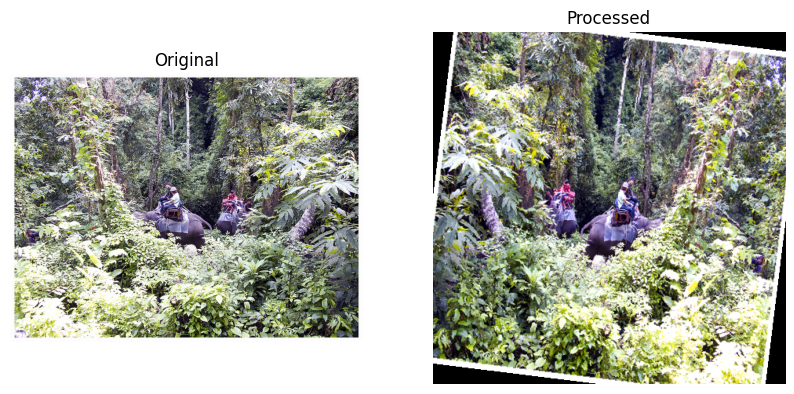

Saved: processed_20/proc_image_8 (1).jpg


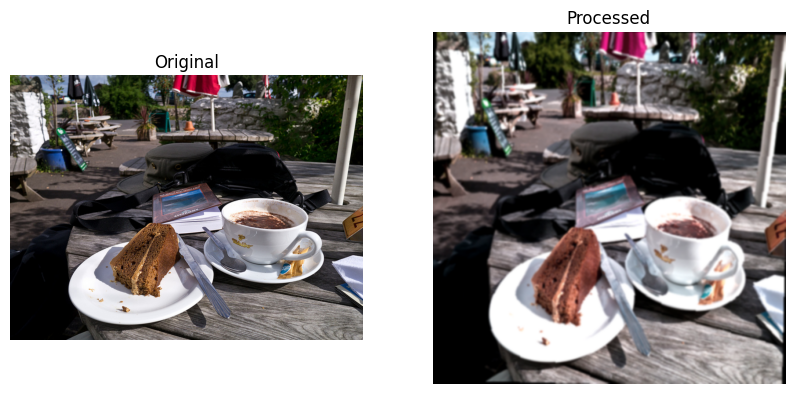

Saved: processed_20/proc_image_14.jpg


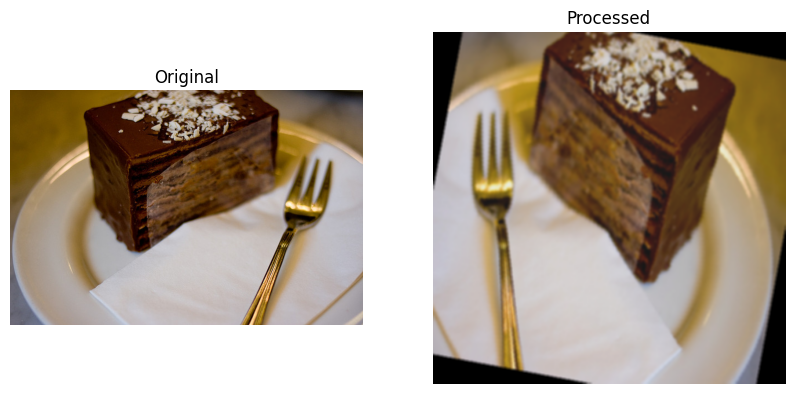

Saved: processed_20/proc_image_18 (1).jpg


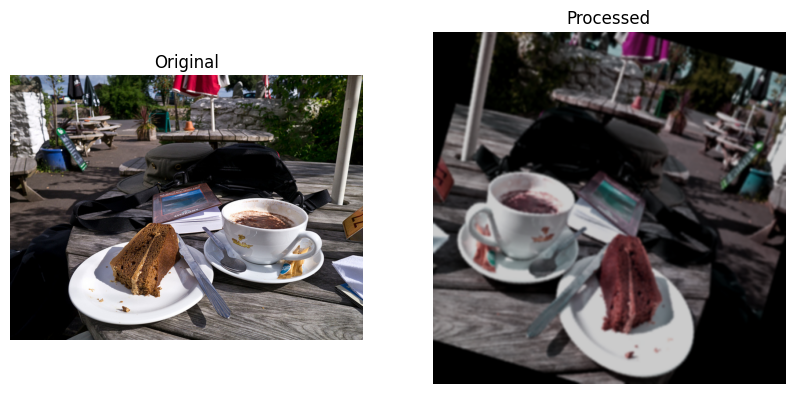

Saved: processed_20/proc_image_20.jpg


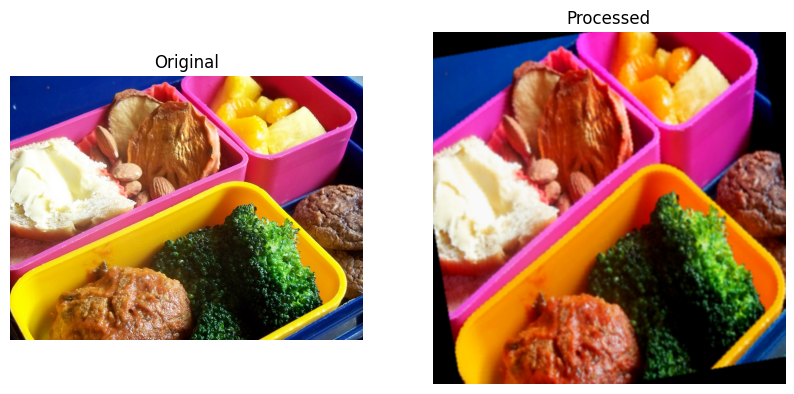

Saved: processed_20/proc_image_1.jpg


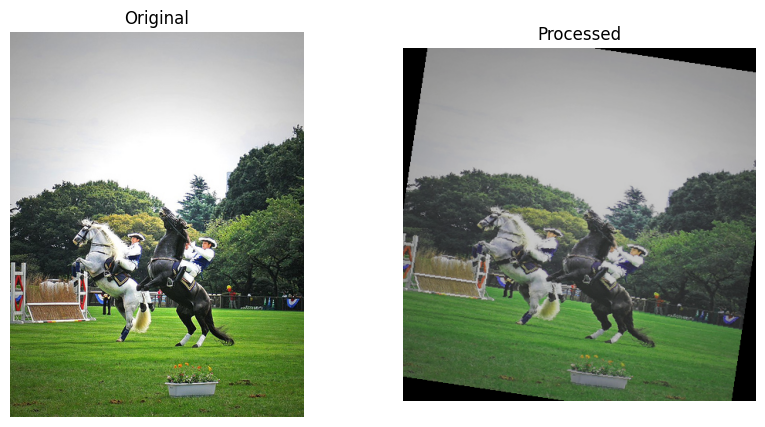

Saved: processed_20/proc_image_7 (1).jpg


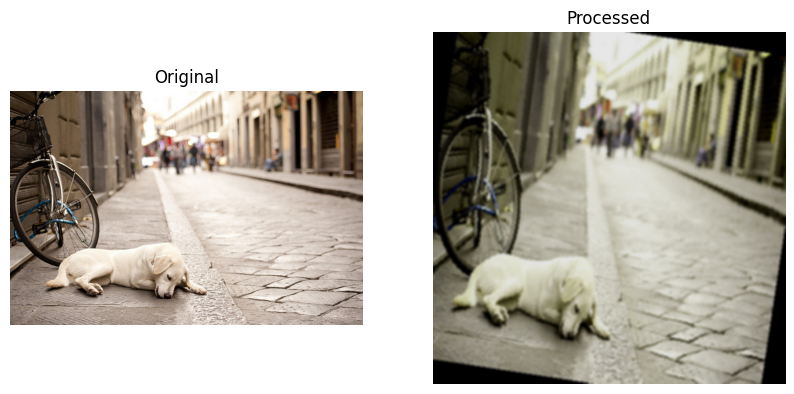

Saved: processed_20/proc_image_9 (1).jpg


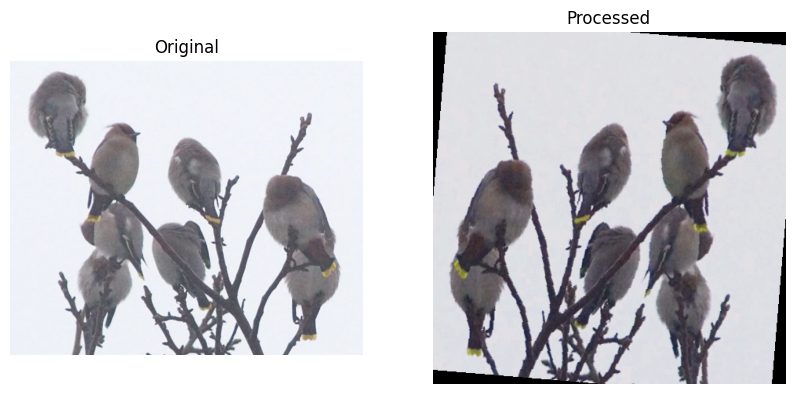

Saved: processed_20/proc_image_16.jpg


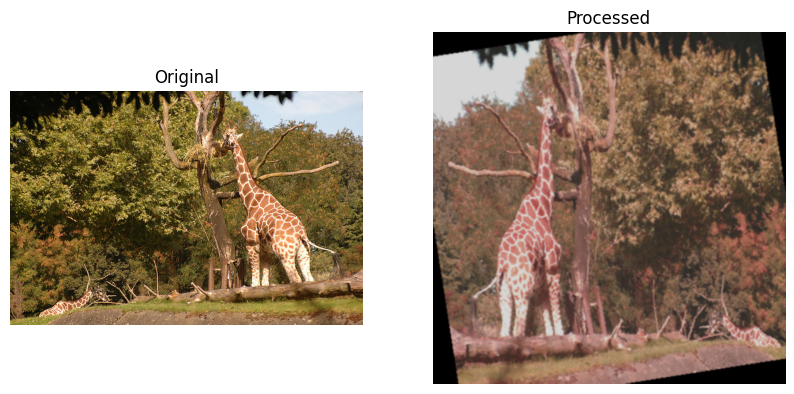

Saved: processed_20/proc_image_2 (1).jpg


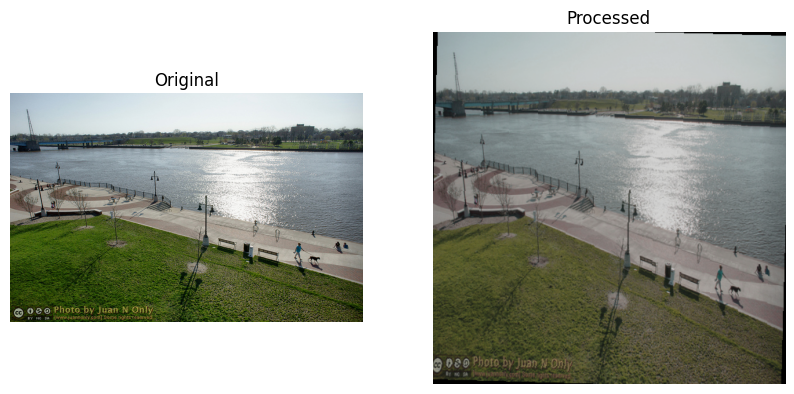

Saved: processed_20/proc_image_13.jpg


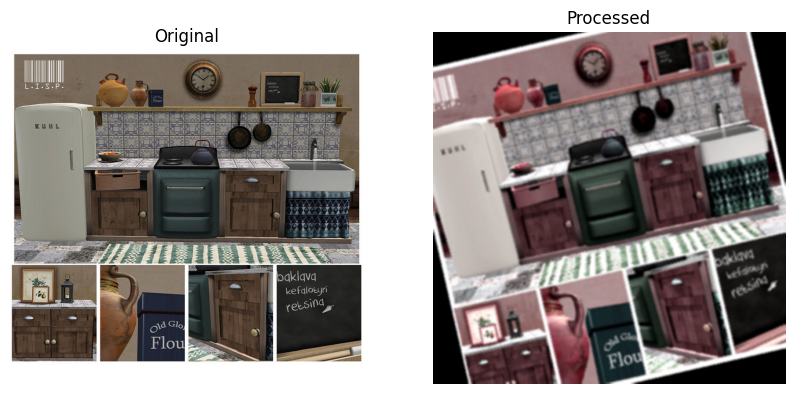

Saved: processed_20/proc_image_15 (1).jpg


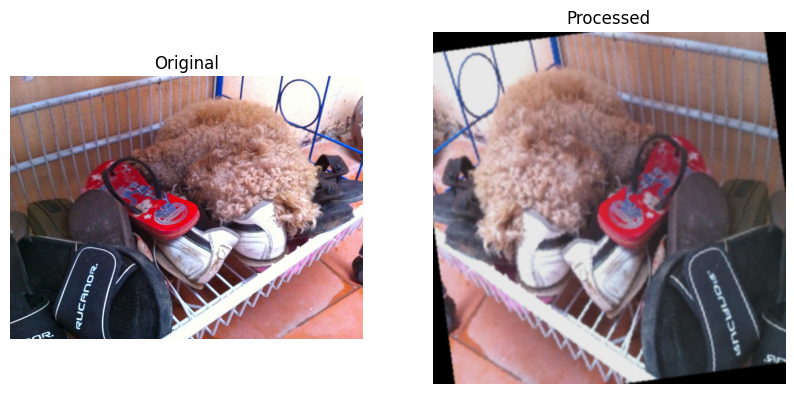

Saved: processed_20/proc_image_6.jpg


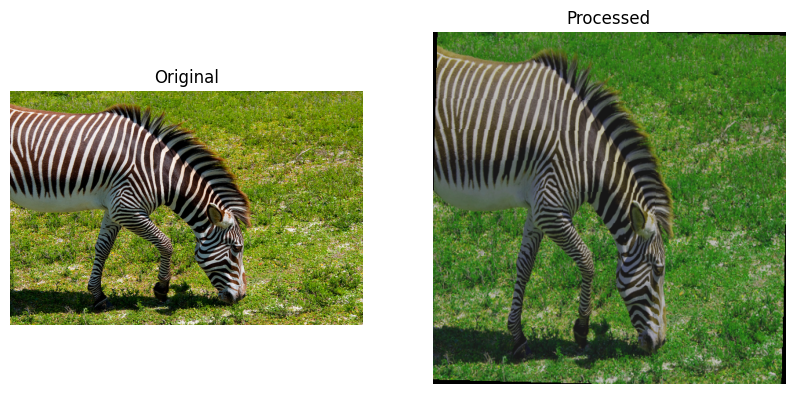

Saved: processed_20/proc_image_4.jpg


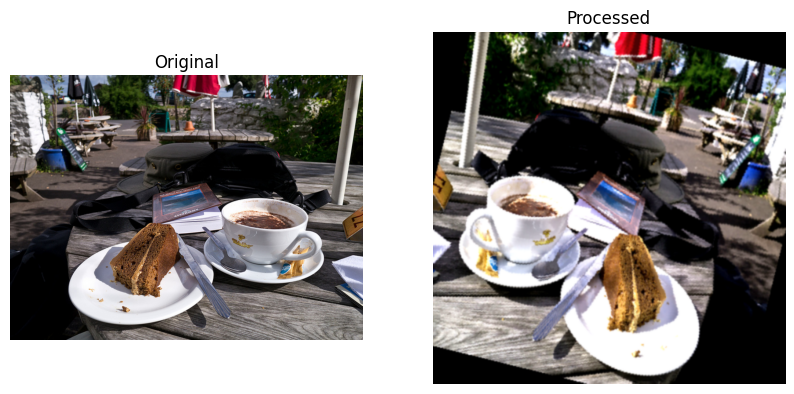

Saved: processed_20/proc_image_20 (1).jpg


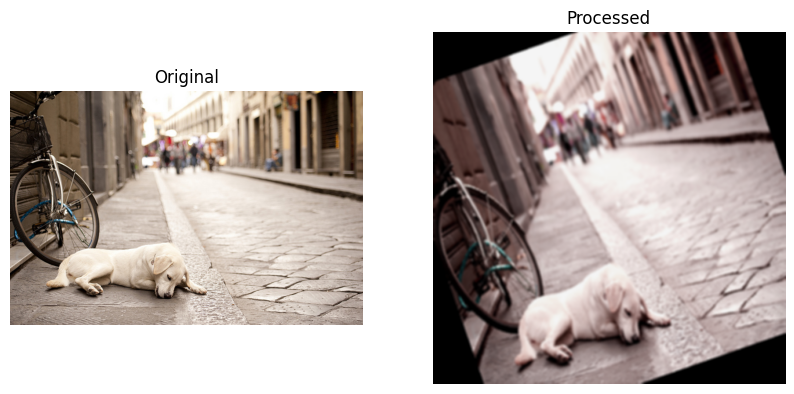

Saved: processed_20/proc_image_9.jpg


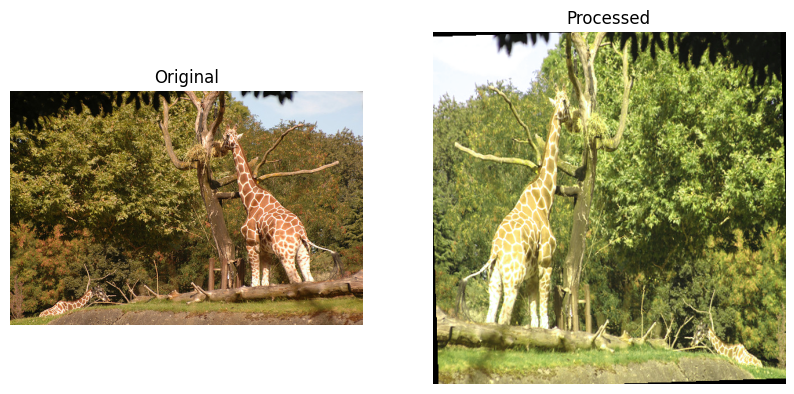

Saved: processed_20/proc_image_2.jpg


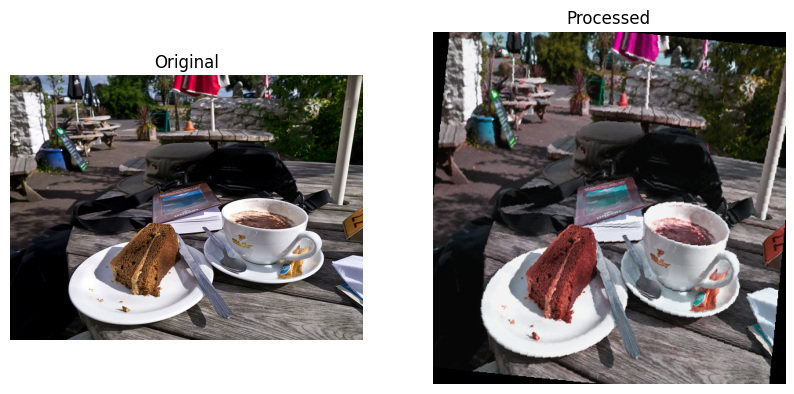

Saved: processed_20/proc_image_14 (1).jpg


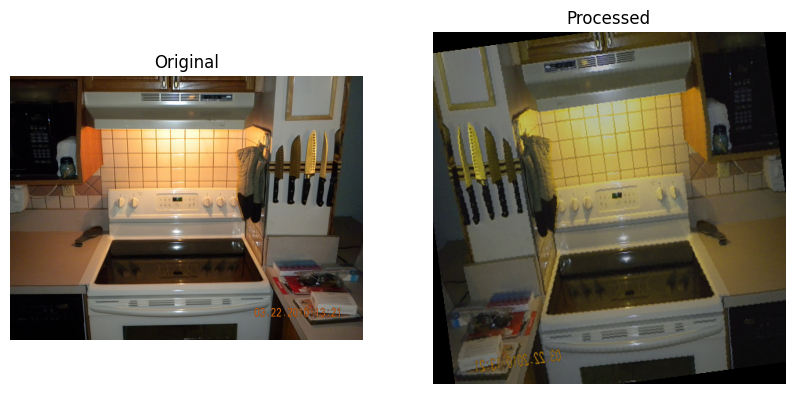

Saved: processed_20/proc_image_19.jpg


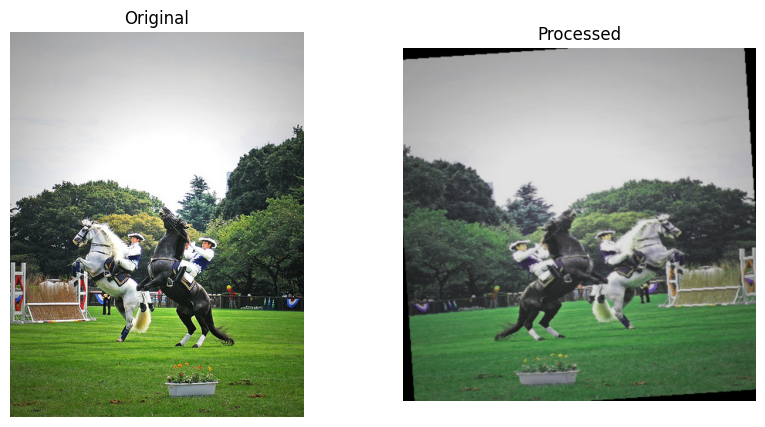

Saved: processed_20/proc_image_7.jpg


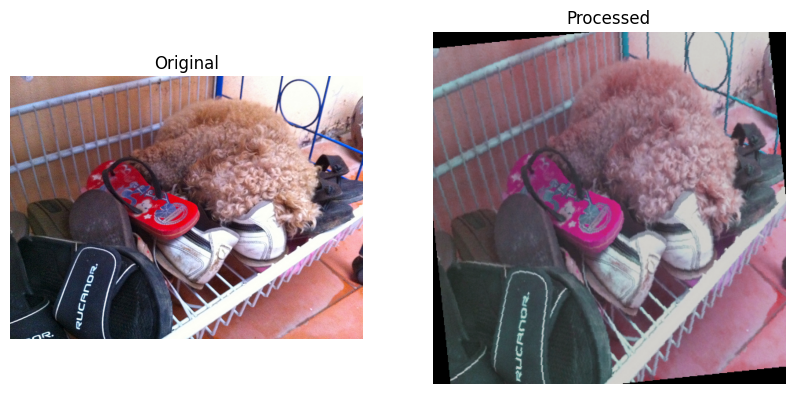

Saved: processed_20/proc_image_6 (1).jpg


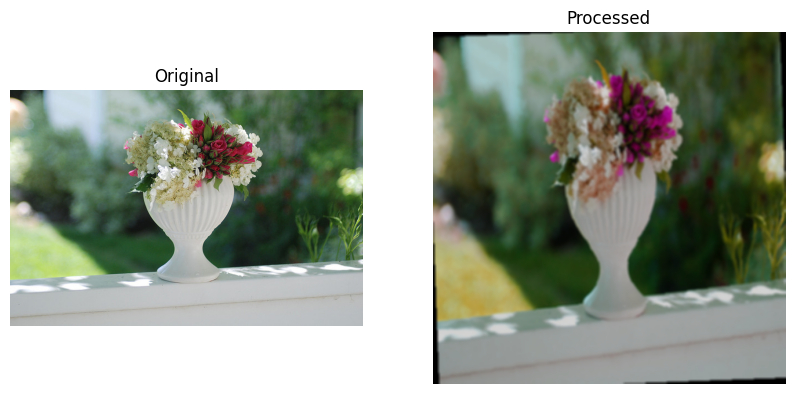

Saved: processed_20/proc_image_3 (1).jpg


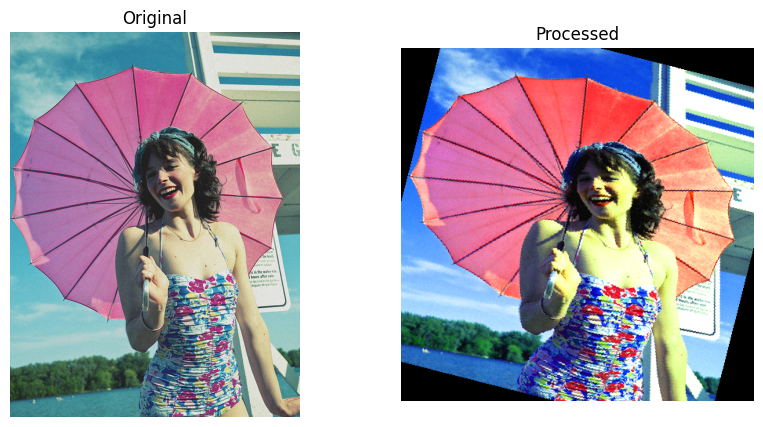

Saved: processed_20/proc_image_5 (1).jpg


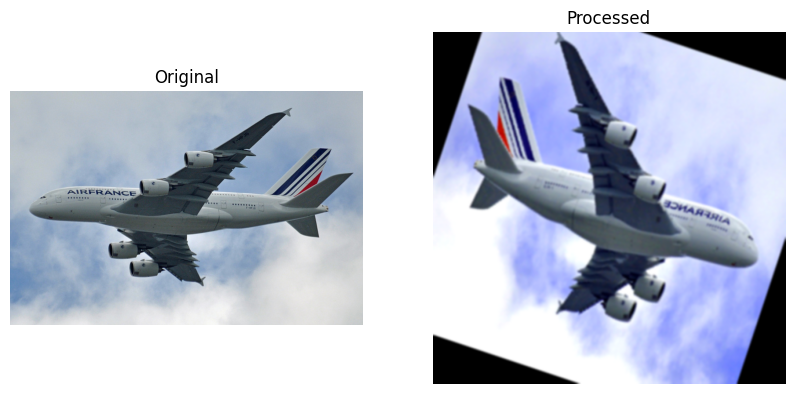

Saved: processed_20/proc_image_11.jpg


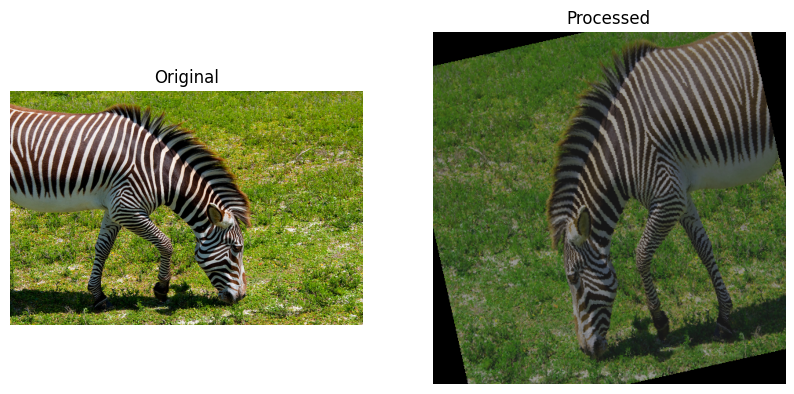

Saved: processed_20/proc_image_4 (1).jpg


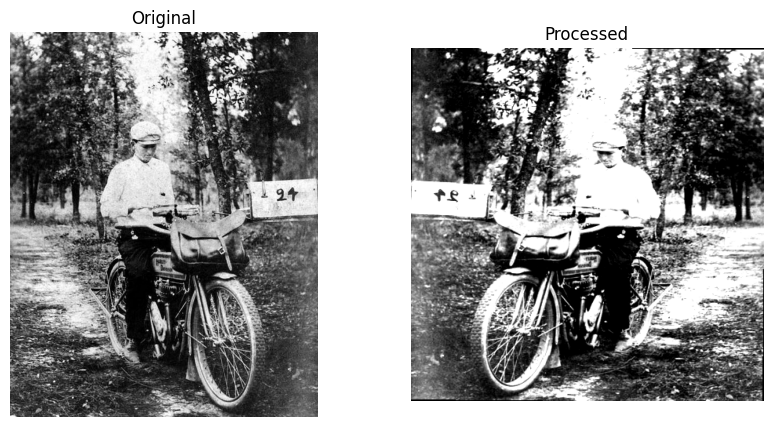

Saved: processed_20/proc_image_12 (1).jpg


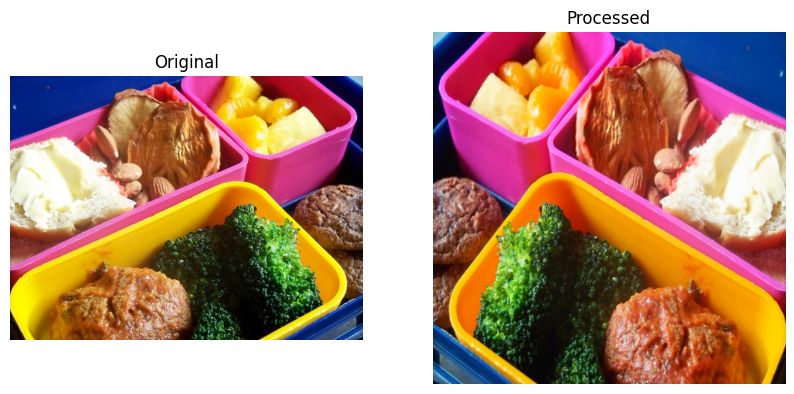

Saved: processed_20/proc_image_1 (1).jpg


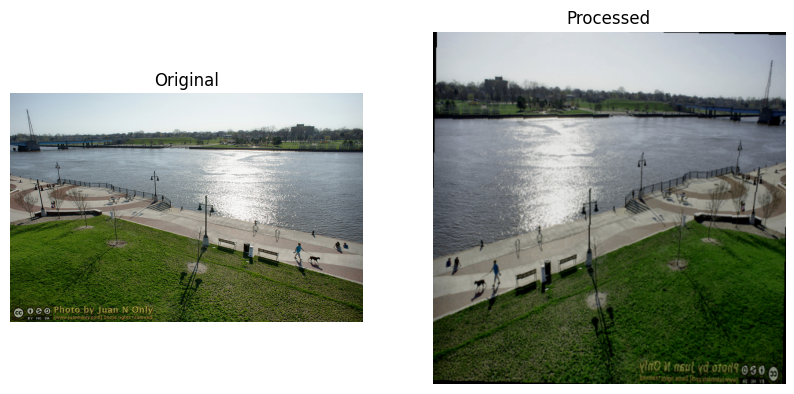

Saved: processed_20/proc_image_13 (1).jpg


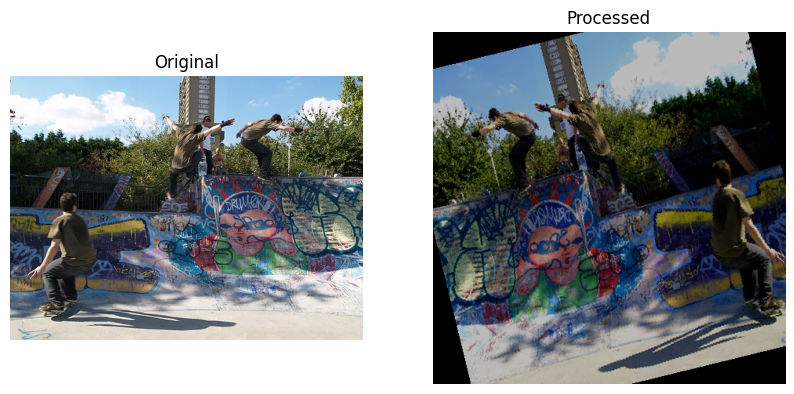

Saved: processed_20/proc_image_10.jpg


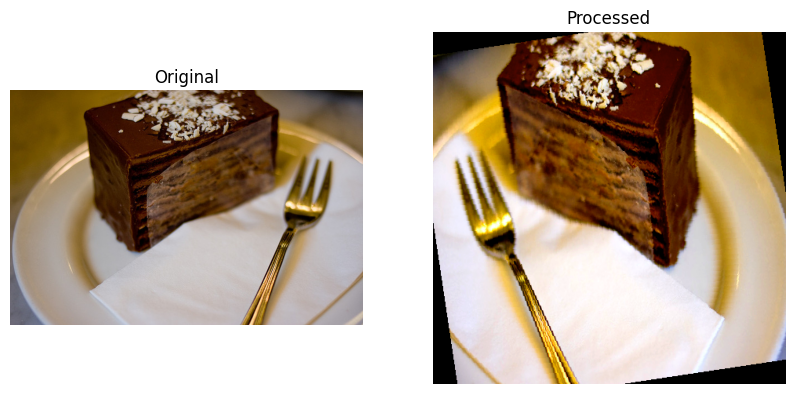

Saved: processed_20/proc_image_18.jpg


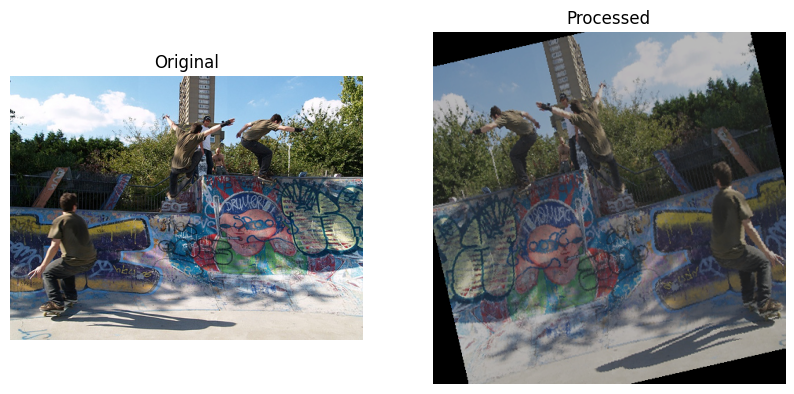

Saved: processed_20/proc_image_10 (1).jpg


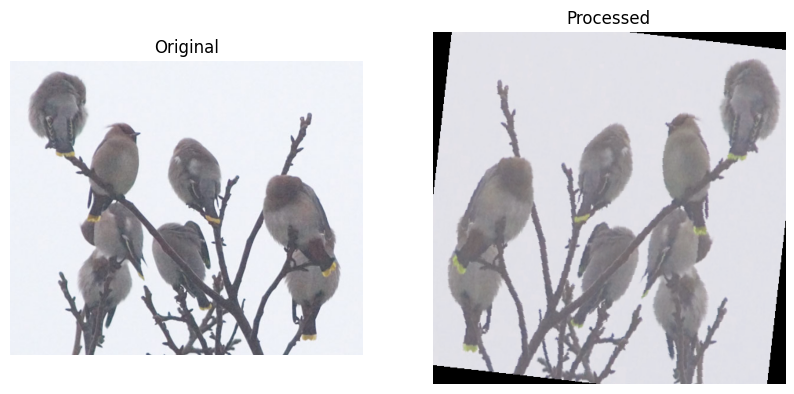

Saved: processed_20/proc_image_16 (1).jpg


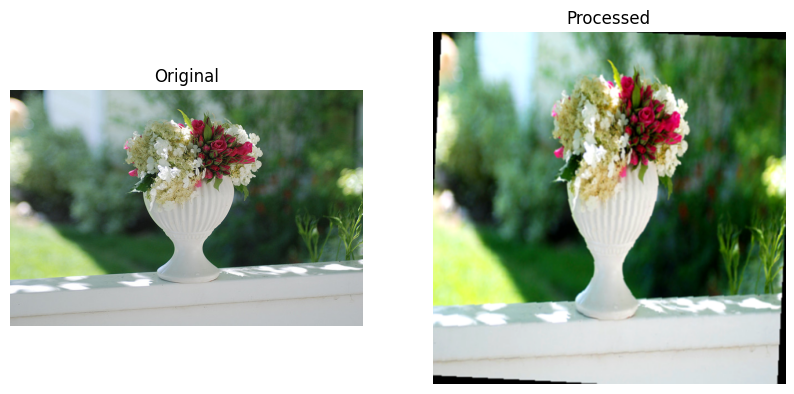

Saved: processed_20/proc_image_3.jpg


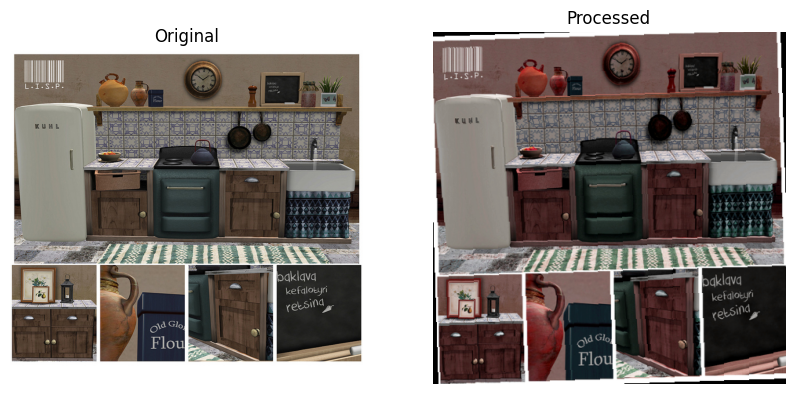

Saved: processed_20/proc_image_15.jpg


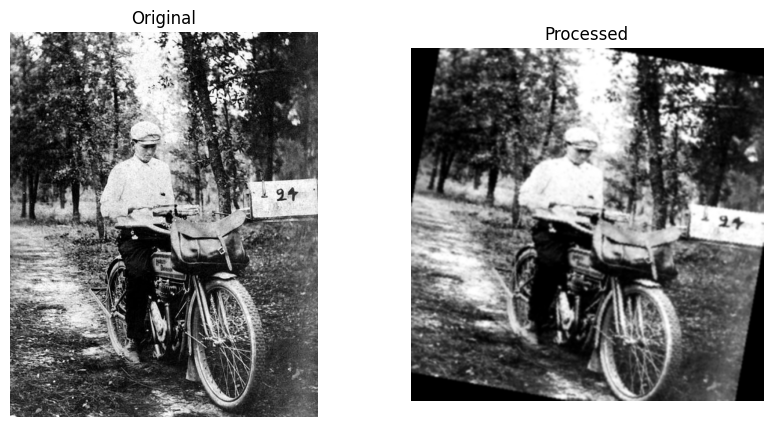

Saved: processed_20/proc_image_12.jpg


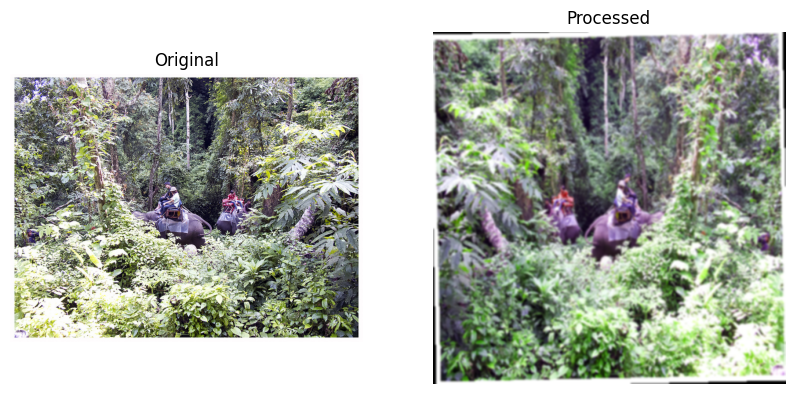

Saved: processed_20/proc_image_8.jpg


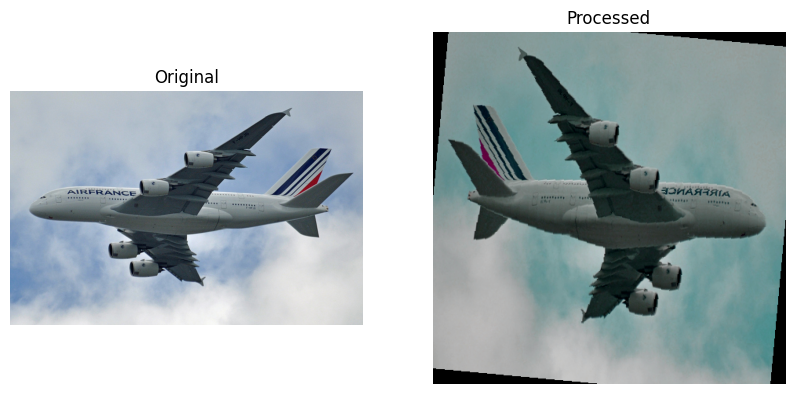

Saved: processed_20/proc_image_11 (1).jpg


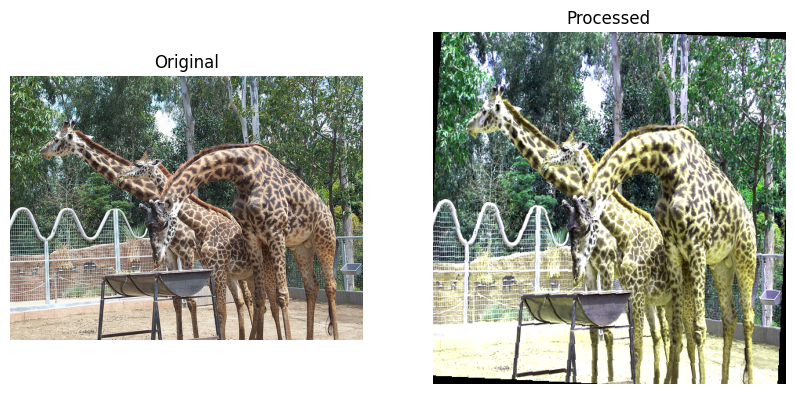

Saved: processed_20/proc_image_17 (1).jpg


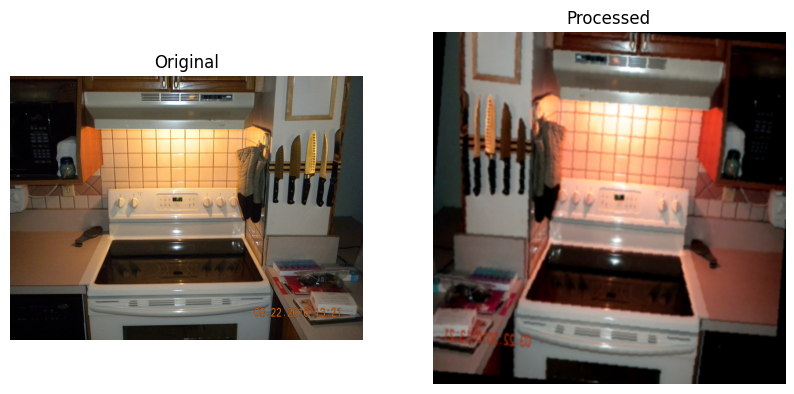

Saved: processed_20/proc_image_19 (1).jpg


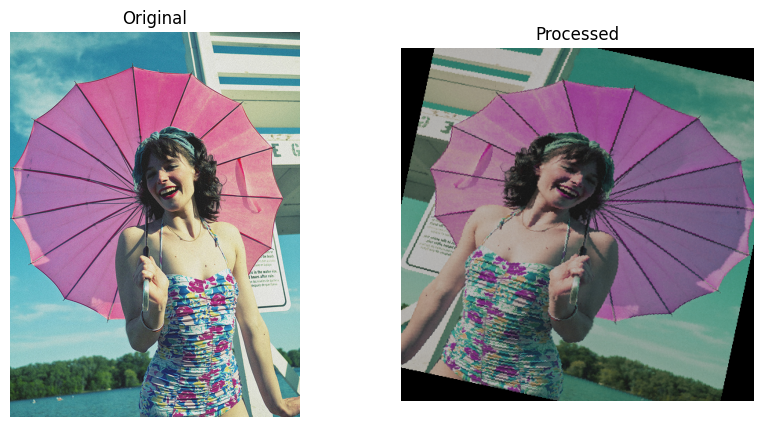

Saved: processed_20/proc_image_5.jpg


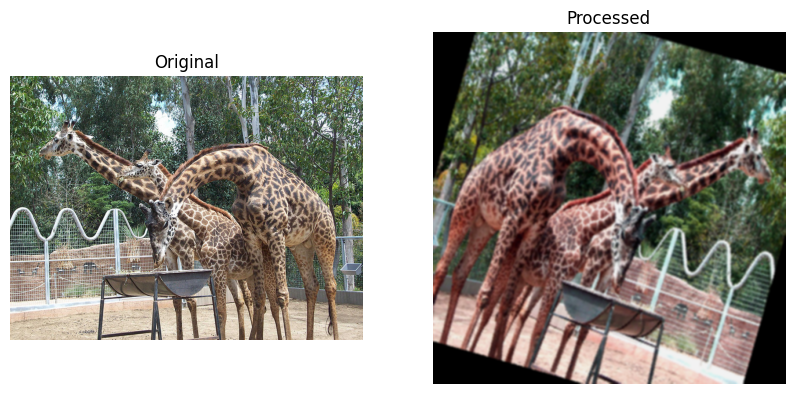

Saved: processed_20/proc_image_17.jpg
✅ Done processing all images!


In [21]:
import os
import random
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as T
import torch

IMAGE_DIR = "my_images"         # ✅ your uploaded images
OUT_DIR = "processed_20"        # folder for processed images
random.seed(20251029)

os.makedirs(OUT_DIR, exist_ok=True)

# List all image files
img_exts = ('.jpg', '.jpeg', '.png', '.bmp', '.tiff')
all_images = [p for p in Path(IMAGE_DIR).iterdir() if p.suffix.lower() in img_exts]

print("Found", len(all_images), "images.")

# Transform pipeline
pipeline = T.Compose([
    T.Resize((450, 450)),
    T.RandomHorizontalFlip(p=0.5),
    T.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.4, hue=0.1),
    T.RandomRotation(degrees=20),
    T.RandomApply([T.GaussianBlur(kernel_size=5)], p=0.5),
    T.RandomApply([T.RandomAdjustSharpness(sharpness_factor=2)], p=0.3),
    T.ToTensor(),
])

def tensor_to_pil(tensor):
    tensor = tensor.clamp(0,1)
    arr = (tensor * 255).byte().permute(1,2,0).numpy()
    return Image.fromarray(arr)

# Process each image
for p in all_images:
    orig = Image.open(p).convert("RGB")
    processed = pipeline(orig)
    processed_pil = tensor_to_pil(processed)

    # Show original and processed
    fig, ax = plt.subplots(1,2, figsize=(10,5))
    ax[0].imshow(orig); ax[0].set_title("Original"); ax[0].axis("off")
    ax[1].imshow(processed_pil); ax[1].set_title("Processed"); ax[1].axis("off")
    plt.show()

    # Save processed
    out_path = os.path.join(OUT_DIR, f"proc_{p.name}")
    processed_pil.save(out_path)
    print("Saved:", out_path)

print("✅ Done processing all images!")
